# Twitter Analysis: Elon Musk


## Project Overview





1. Introduction


2. Twitter Web Scraping


3. Data Analysis and Data Wrangling


4. Sentiment Classification


5. Visualizations


6. Conclusion

<div class="alert alert-block alert-success">
<a href="https://nbviewer.org/github/AlexHuggler/Elon-Musk-Twitter-Usage-Analysis/blob/main/Elon%20Musk%20Twitter%20Scraping%2C%20Text%20Analysis%2C%20and%20NLP%20roBERTa%20Classification.ipynb">View file ipynb on NBviewer, by clicking here, to check out Plotly Graphs below </a>
</div>


# Introduction:


## Elon Musk, a prolific figure of our time, who captures national attention for the technological achievements of his companies, tremendous wealth, entrepreneurial grandeur, and his adoration of memes. The goal of this project will be to gain a historical dataset of Elon Musk's twitter account, as of 10/28/2022, and perform a series of text based analysis, as well as sentiment classification. This will be done in order to determine Elon Musk's use of Twitter over time, the frequency of which he tweets, common themes discussed in his tweets, and more. Given the nature of Mr. Musk's influence on our current era in history, his tweets have been known to sway markets over night. For example, his influence is largely credited with elevating the popularity of the little known cryptocurrency that started as a joke, Dogecoin. In addition, his Twitter use has embroiled him in legal battles with the Security and Exchance Commission, and as of the time of this writing, he has purchased Twitter to be amidst his portfolio of companies. A figure like no other, I determined it to be an interesting exercise to review the Twitter usage of what some refer to as "the cyborg-like man" or the "Thomas Edison of our time", and more recently, Time Magazine's Person of the Year in 2021.

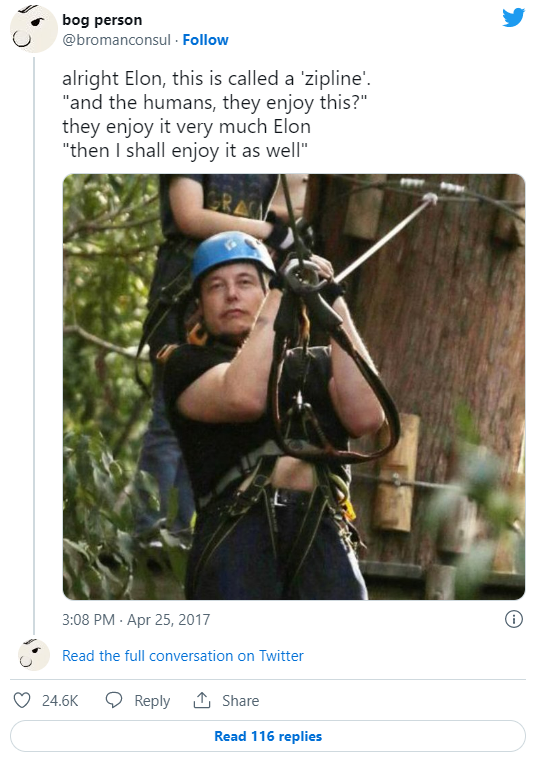

## Twitter Scraping with Snscrape Library


In [58]:
# Importing required libraries
import snscrape.modules.twitter as sntwitter
import os
import pandas as pd
from pandas.api.types import CategoricalDtype
import numpy as np
import re  
from collections import Counter
import warnings
import nltk
from nltk import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
import matplotlib.pyplot as plt; plt.rcdefaults()
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from transformers import AutoModelForSequenceClassification, AutoTokenizer
from scipy.special import softmax 
import csv
import urllib.request
import torch
sns.set(style="darkgrid")

stopword = nltk.corpus.stopwords.words('english')
warnings.filterwarnings("ignore")

### Here I'll be using the Snscrape library to pull in all historical Tweets, as of 10/28/2022, and then save the Tweets to Pandas dataframe, which I'll then save to my file path. This will allow me to not have to rework this step at a later time.

In [2]:
### Note: This Code block will take a several minutes to run.
### In the below code block I've already saved the data out to csv, to allow for easy re-upload.

# Creating list to append tweet data.
tweets_list = []

# Using TwitterSearchScraper to scrape data and append tweets to list. Gets all historical Tweets
for i,tweet in enumerate(sntwitter.TwitterSearchScraper('from:elonmusk').get_items()):
    if i>100000:
        break
    tweets_list.append([tweet.date, tweet.id, tweet.content, tweet.user.username, tweet.user.location, tweet.replyCount, tweet.retweetCount, tweet.likeCount, tweet.lang, tweet.sourceLabel, tweet.user.followersCount, tweet.user.friendsCount, tweet.user.verified ])
    
# Creating a dataframe from the tweets list above 
tweets_df = pd.DataFrame(tweets_list, columns=['Datetime', 'Tweet Id', 'Text', 'Username', 'location', 'reply count', 'retweet count', 'like count', 'language', 'Twitter Access Point', 'Follower Count', ' Friends Count', 'verified'])


In [5]:
tweets_df['Text']=tweets_df['Text'].astype('string')

## Data exploration and data clearning

In [6]:
# Review data types of datframe
tweets_df.dtypes

Unnamed: 0.1             int64
Unnamed: 0               int64
Datetime                object
Tweet Id                 int64
Text                    string
Username                object
location                object
reply count              int64
retweet count            int64
like count               int64
language                object
Twitter Access Point    object
Follower Count           int64
 Friends Count           int64
verified                  bool
dtype: object

### Here it can be seen below that we've brought in 14 columns that reveal the date/time when tweets were posted, the text inclued in the tweet, the twitter access point, reply count, retweent count, like count, follower count, and friend count.

In [7]:
# Reviewing the data to review csv format produced.
tweets_df.head()

,Unnamed: 0.1,Unnamed: 0,Datetime,Tweet Id,Text,Username,location,reply count,retweet count,like count,language,Twitter Access Point,Follower Count,Friends Count,verified
0,0,0,2022-10-28 03:49:11+00:00,1585841080431321088,the bird is freed,elonmusk,Twitter HQ,57663,128631,730472,en,Twitter for iPhone,110553384,122,True
1,1,1,2022-10-28 01:50:49+00:00,1585811291851018241,Falcon rockets to orbit as seen from LA https:...,elonmusk,Twitter HQ,6857,16499,189436,en,Twitter for iPhone,110553384,122,True
2,2,2,2022-10-27 21:45:47+00:00,1585749627365515266,@Gfilche @Twitter 🤣,elonmusk,Twitter HQ,632,246,7052,und,Twitter for iPhone,110553384,122,True
3,3,3,2022-10-27 16:17:39+00:00,1585667048020901888,@PeterSchiff 🤣 thanks,elonmusk,Twitter HQ,670,420,17577,en,Twitter for iPhone,110553384,122,True
4,4,4,2022-10-27 13:19:25+00:00,1585622194696044544,@ZubyMusic Absolutely,elonmusk,Twitter HQ,1281,1152,42896,en,Twitter for iPhone,110553384,122,True


In [8]:
# dimensions of dataframe
tweets_df.shape

(17445, 15)

In [9]:
# Review of the "Username" field to ensure data quality and that no other users were pulled in
tweets_df.Username.unique()

array(['elonmusk'], dtype=object)

### By looking at the top and bottom data records, we can see that the first initial tweet recorded by the scraper is from June 4th 2010, while the most recent post on 10/28/2022. In total, over that nearly 12 year period, Elon produced roughly 17K individual tweets and replies.

In [11]:
tweets_df.tail()

,Unnamed: 0.1,Unnamed: 0,Datetime,Tweet Id,Text,Username,location,reply count,retweet count,like count,language,Twitter Access Point,Follower Count,Friends Count,verified
17440,17440,17440,2011-12-03 08:22:07+00:00,142881284019060736,That was a total non sequitur btw,elonmusk,Twitter HQ,27,9,51,en,Twitter for iPhone,110555351,122,True
17441,17441,17441,2011-12-03 08:20:28+00:00,142880871391838208,"Great Voltaire quote, arguably better than Twa...",elonmusk,Twitter HQ,23,29,53,en,Twitter for iPhone,110555351,122,True
17442,17442,17442,2011-12-01 10:29:04+00:00,142188458125963264,I made the volume on the Model S http://t.co/w...,elonmusk,Twitter HQ,29,13,75,en,Twitter Web Client,110555351,122,True
17443,17443,17443,2011-12-01 09:55:11+00:00,142179928203460608,Went to Iceland on Sat to ride bumper cars on ...,elonmusk,Twitter HQ,33,22,188,en,Twitter Web Client,110555351,122,True
17444,17444,17444,2010-06-04 18:31:57+00:00,15434727182,"Please ignore prior tweets, as that was someon...",elonmusk,Twitter HQ,988,558,6023,en,Twitter Web Client,110555351,122,True


## Distributions of Like, Retweets and Reply counts.

In [12]:
# Get Summary stats of each category to better understand value distributions
tweets_df.describe()


,Unnamed: 0.1,Unnamed: 0,Tweet Id,reply count,retweet count,like count,Follower Count,Friends Count
count,17445.000000,17445.000000,1.744500e+04,17445.000000,17445.000000,1.744500e+04,1.744500e+04,17445.0
mean,8722.000000,8722.000000,1.185936e+18,1616.132817,2931.004872,3.192033e+04,1.105545e+08,122.0
std,5036.082059,5036.082059,3.093505e+17,6064.134762,12463.284181,1.049149e+05,5.784134e+02,0.0
min,0.000000,0.000000,1.543473e+10,0.000000,0.000000,3.000000e+00,1.105534e+08,122.0
25%,4361.000000,4361.000000,1.024363e+18,66.000000,68.000000,1.292000e+03,1.105540e+08,122.0
50%,8722.000000,8722.000000,1.246208e+18,230.000000,270.000000,4.704000e+03,1.105545e+08,122.0
75%,13083.000000,13083.000000,1.426316e+18,797.000000,1192.000000,1.808500e+04,1.105550e+08,122.0
max,17444.000000,17444.000000,1.585841e+18,193966.000000,681768.000000,4.781242e+06,1.105555e+08,122.0


(-100.0, 70000.0)

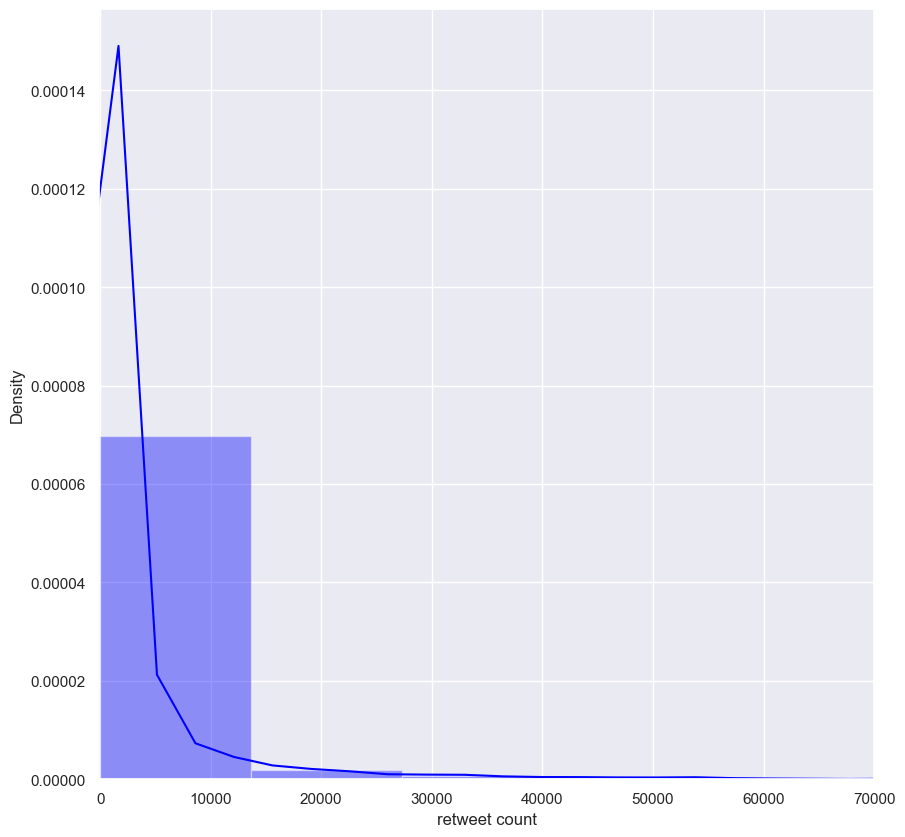

In [13]:
#Distribution Plot for retweets
plt.figure(figsize=(10,10))
sns.distplot(tweets_df["retweet count"],color='blue')
plt.xlim(-100,70000)

(-100.0, 7000.0)

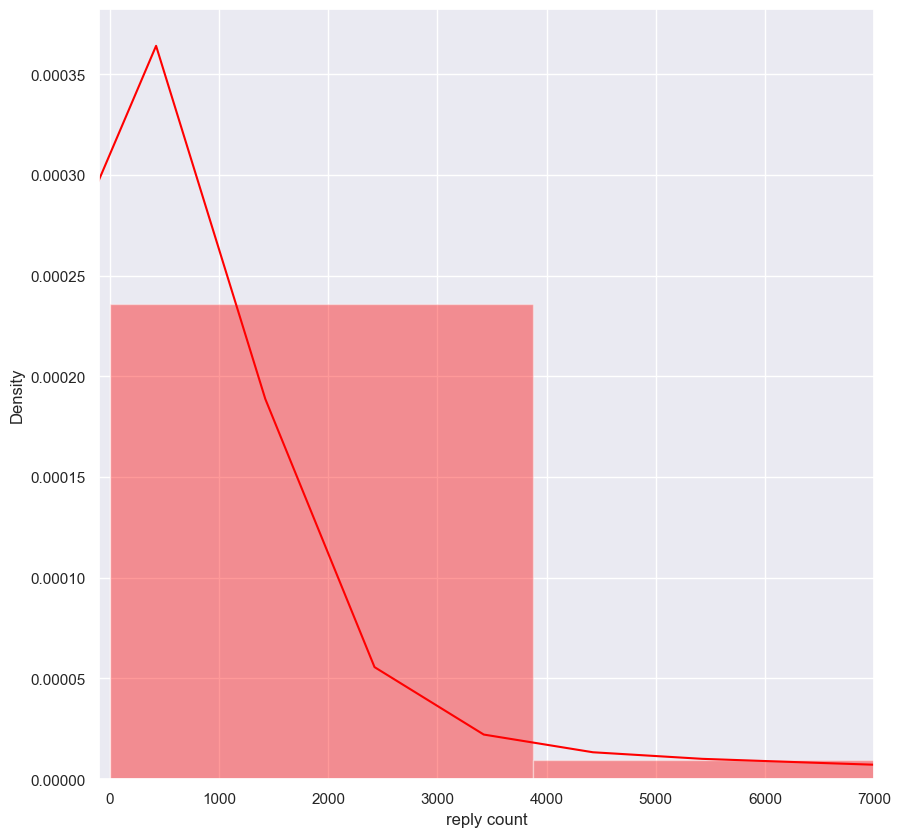

In [14]:
#Distribution Plot for reply counts
plt.figure(figsize=(10,10))
sns.distplot(tweets_df["reply count"], color='red')
plt.xlim(-100,7000)

(-100.0, 250000.0)

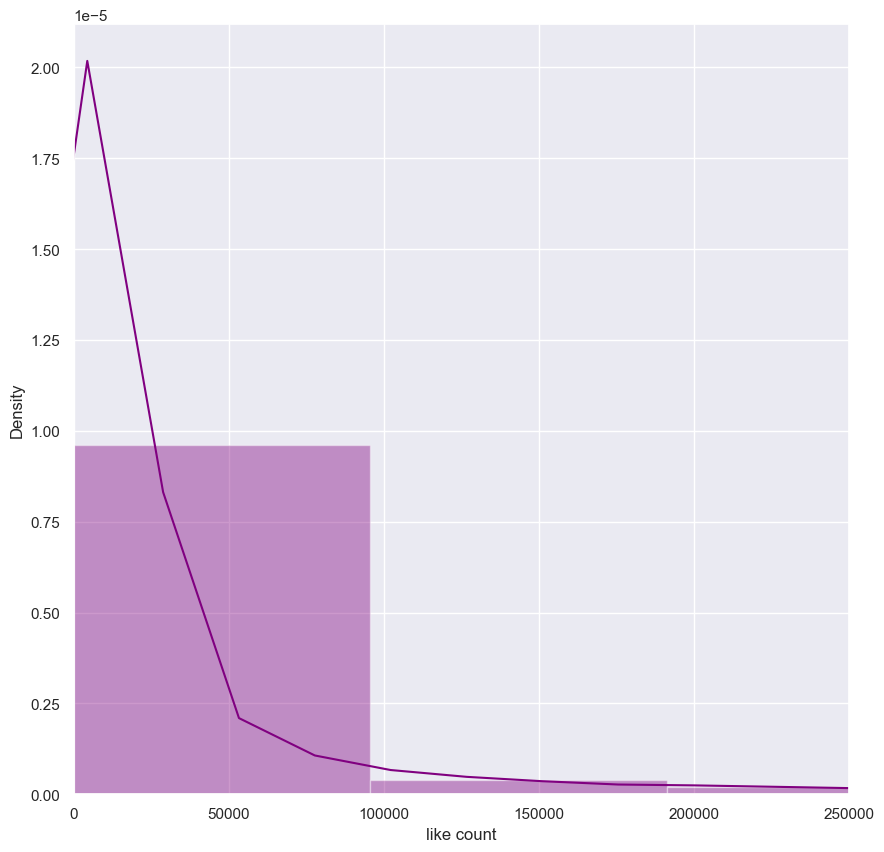

In [15]:
#Distribution Plot for like counts
plt.figure(figsize=(10,10))
sns.distplot(tweets_df["like count"], color='purple')
plt.xlim(-100,250000)


### From the above distribution plots and summary statistics, it can be seen that given Elon Musk's popularity on twitter, he has a large number of posts that go into the far right hand side of the above distributions. While some posts garner 682K retweets, most of the normal activity associated with his account is much less (<10K retweets), but albeit still extremely large, especially considering the frequency at which he posts. Later on in the analysis, it'll be seen that his Twitter account popularity has increased dramatically over the last 2 years, on the basis of like counts and retweets.

## Time Series/Day/Hour Analysis and further Data Preprocessing

In [16]:
tweets_df['Datetime']=pd.to_datetime(tweets_df['Datetime'])

In [17]:
# convert datetime column to just date
tweets_df['Date'] = pd.to_datetime(tweets_df['Datetime']).dt.date

In [18]:
# Creating temporary daterame to plot Daily Tweet Counts
daily_tweets = pd.DataFrame(tweets_df.groupby(['Date','Datetime'])['Text'].nunique().reset_index())
daily_tweets = daily_tweets.rename({'Text': 'Tweet Count'}, axis='columns')
daily_tweets["Month"]= pd.to_datetime(daily_tweets["Date"], dayfirst=False)
daily_tweets["Year"]= daily_tweets["Month"].dt.year
daily_tweets["Month"]= daily_tweets["Month"].dt.month_name()
daily_tweets["Hour"]= daily_tweets["Datetime"].dt.hour
daily_tweets["Day"]= daily_tweets["Datetime"].dt.day_name()

cats = [ 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
cat_type = CategoricalDtype(categories=cats, ordered=True)
daily_tweets['Day'] = daily_tweets['Day'].astype(cat_type)

daily_tweets

,Date,Datetime,Tweet Count,Month,Year,Hour,Day
0,2010-06-04,2010-06-04 18:31:57+00:00,1,June,2010,18,Friday
1,2011-12-01,2011-12-01 09:55:11+00:00,1,December,2011,9,Thursday
2,2011-12-01,2011-12-01 10:29:04+00:00,1,December,2011,10,Thursday
3,2011-12-03,2011-12-03 08:20:28+00:00,1,December,2011,8,Saturday
4,2011-12-03,2011-12-03 08:22:07+00:00,1,December,2011,8,Saturday
...,...,...,...,...,...,...,...
17437,2022-10-27,2022-10-27 13:19:25+00:00,1,October,2022,13,Thursday
17438,2022-10-27,2022-10-27 16:17:39+00:00,1,October,2022,16,Thursday
17439,2022-10-27,2022-10-27 21:45:47+00:00,1,October,2022,21,Thursday
17440,2022-10-28,2022-10-28 01:50:49+00:00,1,October,2022,1,Friday


### To discern if there's certian patterns in the data that exist in terms of when tweets are posted by hour or by day, I'll be examining the distributions of tweet count by day of the week, as well as hour of day. 

In [19]:
# Create df for tweet counts by day, to discern if there's certian patterns in the data that exist in terms of when tweets are posted
day_tweets = pd.DataFrame(daily_tweets.groupby(['Day'])['Tweet Count'].sum().reset_index())


day_tweets

,Day,Tweet Count
0,Monday,2329
1,Tuesday,2298
2,Wednesday,2294
3,Thursday,2730
4,Friday,2816
5,Saturday,2553
6,Sunday,2425


### In the below bar chart, we can see that Mr.Musk's propensity to tweet has been historically higher around Thursday, Friday,  Saturday, and Sunday, versus earlier in the week.

In [20]:
# Horizontal Bar Plot to show distribution of tweets by day
#plt.bar(day_tweets["Day"],day_tweets["Tweet Count"])
bar1 =px.bar(day_tweets,day_tweets["Day"],day_tweets["Tweet Count"])
# Show Plot
#plt.show()
bar1.show()

In [21]:
# Create df for tweet counts by hour, to discern if there's certian patterns in the data that exist in terms of when tweets are posted
hourly_tweets = pd.DataFrame(daily_tweets.groupby(['Hour'])['Tweet Count'].sum().reset_index())
hourly_tweets

,Hour,Tweet Count
0,0,879
1,1,937
2,2,770
3,3,710
4,4,805
5,5,761
6,6,742
7,7,739
8,8,588
9,9,372


### From the below plot, we're able to see that the historical distribution of Tweets is centered mostly in the evenings and early mornings, with the lowest amount of tweets occurring between 9am-2pm. However, this distribution doesn't account for any changes in Mr. Musk's time zone location due to travel throughout a given day. Therefore, this distribution most likely misrepresents some aspects of Mr.Musk's historical twitter use.

In [22]:
# Horizontal Bar Plot to show distribution of tweets by hour of day
#plt.bar(hourly_tweets["Hour"],hourly_tweets["Tweet Count"])
bar2 = px.bar(hourly_tweets,hourly_tweets["Hour"],hourly_tweets["Tweet Count"])
# Show Plot
#plt.show()
bar2.show()

### By plotting the count of Tweets and Replies by day over time, we're able to see a sense of Elon Musk's Twitter usage over time. It can be seen that since his first tweet in 2010, that he had remained fairly inactive until the end of 2011. From there we can see a continuous increase in frequency over time with the highest peak in 2020. In addition, we can see that his Tweets and replies were the highest in 2020, with a total count of 3241.

In [23]:
# Create df for tweet counts by date
over_time_tweets = pd.DataFrame(daily_tweets.groupby(['Date'])['Tweet Count'].sum().reset_index())


In [29]:
#Plotting Time-series of tweet counts 
fig = px.line(data_frame=over_time_tweets, x='Date', y='Tweet Count',
              hover_name="Date",color_discrete_sequence = ['#4169E1'], 
              title="Daily Tweet Count (June 4,2010 to Oct 28, 2022)")
fig.show()

In [26]:
# Reviewing which years had the highest amount of Tweets&Replies
daily_tweets.groupby('Year')[['Tweet Count']].sum()

,Tweet Count
Year,
2010,1
2011,40
2012,258
2013,407
2014,186
2015,316
2016,727
2017,1119
2018,2189


#### It can be seen below that cumulatively, 2022 has outperformed other years in terms of "like counts" for Mr.Musk's posts.

In [30]:
# Distribution of like counts over time 
hist1 = px.histogram(tweets_df, x=tweets_df["like count"], y=tweets_df["Date"],
                   hover_data=tweets_df.columns)
hist1.show()

### After reviewing some general information about the distribution and timing of tweets over the past few years, I'll then be reviewing the content of the texts to better understand what key themes Elon talks about in his Tweets and replies. It goes without saying that Tesla and other well known topics of conversaton like "Dogecoin" will come up. However, it'll be fascinating to see what other underlying topics may be historically recurring themes in his Twitter feed, for which he's less known for.

In [31]:
# Creating temporary daterame to plot counts of @mentions in tweets
review_df =pd.DataFrame()
tweets_df['mentions'] = tweets_df['Text'].apply(lambda x: re.findall('@([\w\-]+):?',x) if len(re.findall('@([\w\-]+):?',x))>0 else '_' )
tweets_df['mentions']=(tweets_df['mentions'].transform(lambda x: ",".join(map(str,x))))
tweets_df['mentions'].value_counts()


_                           4278
WholeMarsBlog                227
teslaownersSV                133
BillyM2k                     126
Erdayastronaut               118
                            ... 
mkarolian,Tesla                1
WholeMarsBlog,PPathole         1
RenataKonkoly,Sneakyness       1
EuroSandor,RSprachrohr         1
jonlovett                      1
Name: mentions, Length: 8036, dtype: int64

In [32]:
reviewdf=tweets_df[tweets_df.mentions != "_"]
reviewdf=pd.DataFrame(reviewdf.groupby(['mentions'])['Text'].nunique().reset_index())

review_df

""


In [33]:
reviewdf=reviewdf[reviewdf.Text > 10]
reviewdf.sort_values(by =('Text'), ascending=False)


,mentions,Text
4157,WholeMarsBlog,214
7433,teslaownersSV,120
1086,Erdayastronaut,110
2710,PPathole,103
4944,cleantechnica,102
...,...,...
5358,fermatslibrary,12
2142,LanceUlanoff,11
7497,"teslaownersSV,Tesla",11
5263,elonmusk,11


### From the analysis below, we can get a sense of which Twitter users Mr.Musk has engaged with more often. We can see below that the user 'WholeMarsBlog' is the most engaged with user based on our assumptions of only looking at tweets with unqiue '@' mentions in them. We can also see that the Twitter Accounts WholeMarsBlog, followed by teslaownersSV, Erdayastronaut, PPathole, and others, are among Musks top use mentions.

In [34]:
fig2 = px.bar(reviewdf, x='Text', y='mentions', text_auto='.2s')
fig2.show()


In [35]:
#Cumulative analysis of various words

all_sentences = []

for word in tweets_df['Text']:
    all_sentences.append(word)

#all_sentences


lines = []
for line in all_sentences:    
    words = line.split()
    for w in words: 
        lines.append(w.lower())

In [36]:
#Removes Links and making them blanks
lines = [re.sub(r'https?[A-Za-z0-9:/._\-]+','',x) for x in lines]
#Removing Punctuation and making them blanks
lines = [re.sub(r'(&amp;)', '', x) for x in lines]

# Setting and removing Stopwords from list and removing blanks 
lines2=[]

for w in lines:
    if w not in stopword:
        lines2.append(w)

clean_text = []

for word in lines2:
    if word != '':
        clean_text.append(word)
        

In [37]:
#Getting Unique Word Counts for each item in text. 
Counts = Counter(clean_text)


In [38]:
# Create dataframe for Word Counts. Here we can see roughly 21K unique word instances, 
word_count_df =  pd.DataFrame(Counts.items(), columns=['Word','Count'])
word_count_df

,Word,Count
0,bird,1
1,freed,2
2,falcon,198
3,rockets,52
4,orbit,116
...,...,...
31340,ice!,1
31341,vlad's,1
31342,rink,1
31343,nuys.,1


In [39]:
# Filter the Word_count dataframe to extract a list of values with high frequencies.

rslt_df = word_count_df.loc[word_count_df['Count'] > 100] 

fig3 = px.bar(rslt_df, x='Count', y='Word', text_auto='.2s',height = 1000)
fig3.show()


### We can see from the above plot Elon Musk's most common text responses on twitter. Some are related to specific users and  "🤣🤣" appears to be his most favorite emoji response. In addition, Tesla, Spacex, and telsa related twitter groups, like "teslarati", are among the most popular topics recurring in his twitter content. In addition, a word cloud is created below, to help further visualize the most frequently occurring words.

### One key finding is that Mr.Musk engages with the Tesla fan base quite extensively, which speaks to his active engagement with customers and prospective customers. It could be inferred that he's deriving substantial brand equity and favorability by this form of consumer engagement by merely engaging with customers/potential customers on Twitter.

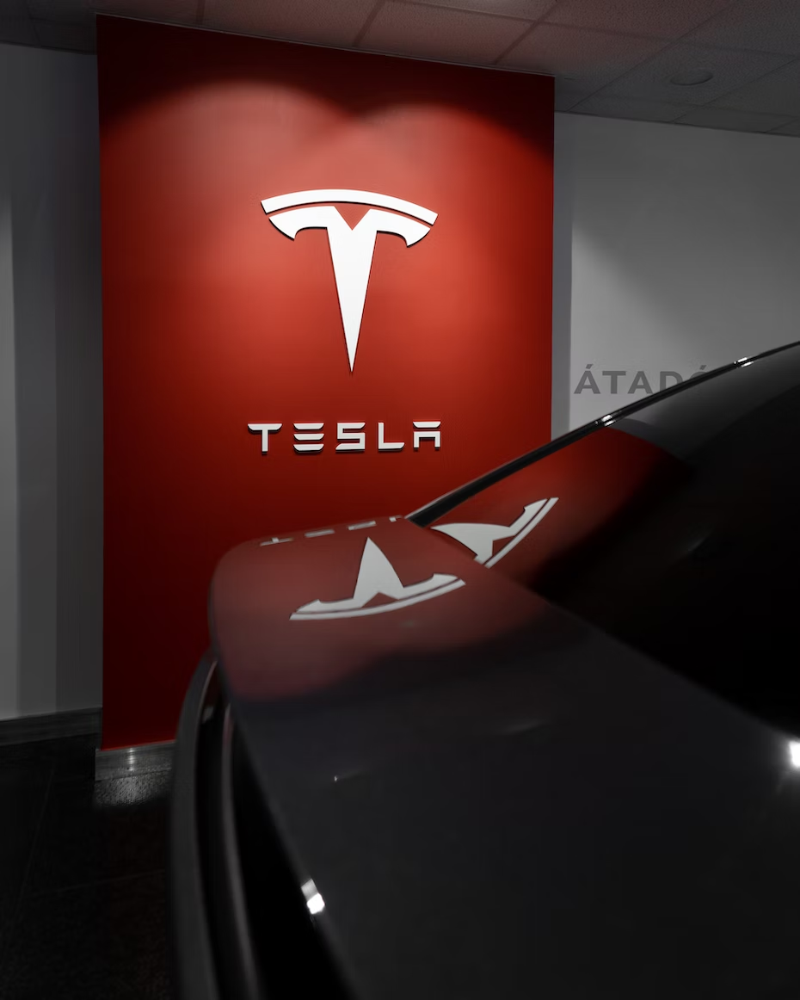

#### WordCloud for further visualization of most commonly used text in Tweets from Elon Musk

In [40]:
# Preparing text for visualization in word cloud
eg = ''.join(clean_text)

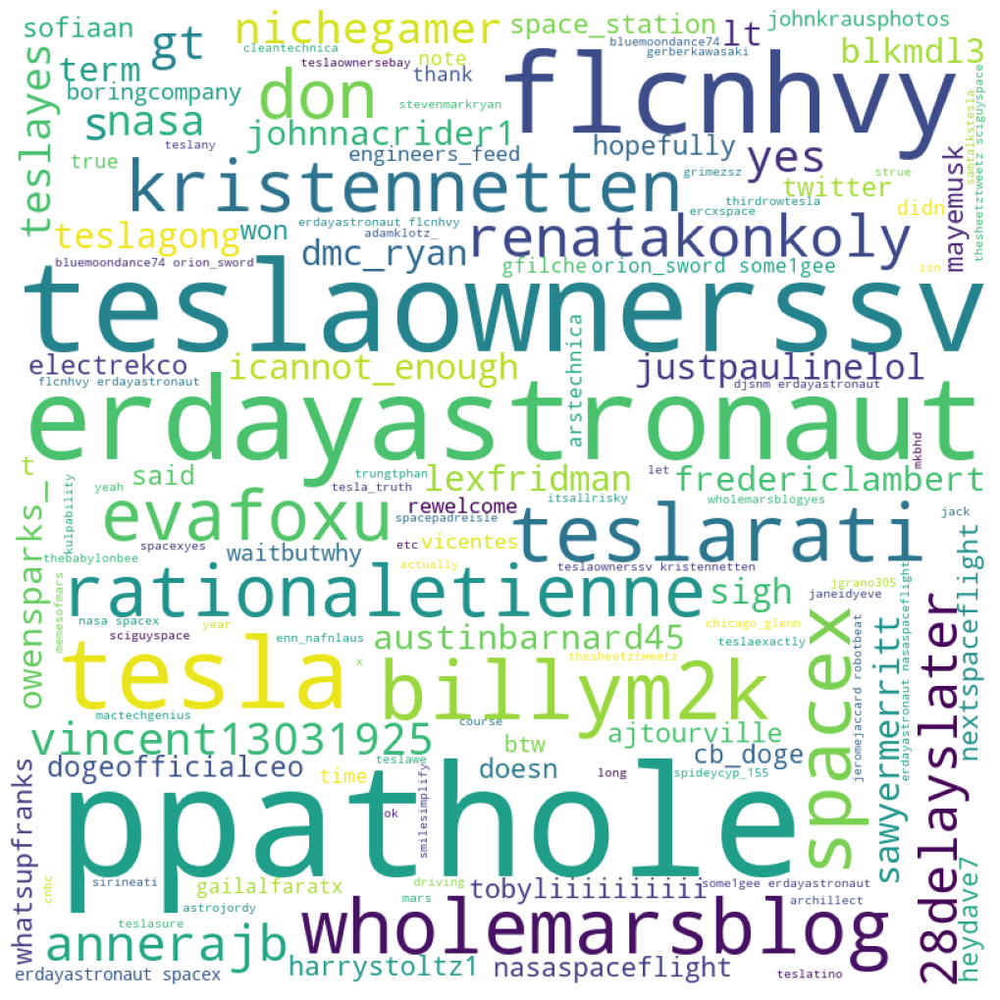

In [41]:
from wordcloud import WordCloud, STOPWORDS
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                min_font_size = 10).generate(eg)
 
#plot the WordCloud image                      
plt.figure(figsize = (10, 10), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
 
plt.show()

## Utilizing Roberta Transformer Model to classify emotions of Tweets

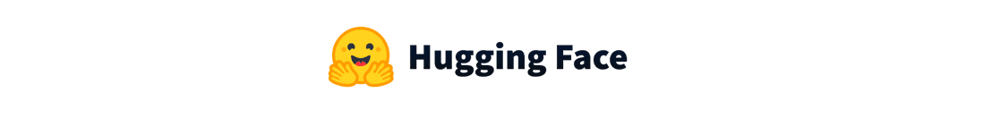

### Below I'll be utilizing the Huggingface library to perform sentiment analysis on each of the Tweets/Replies in the dataset. Specifically, I'll be using a model called "Twitter-roBERTa-base for Sentiment Analysis" (Link for reference: https://huggingface.co/cardiffnlp/twitter-roberta-base-sentiment), which has been pre-trained on roughly 58 mllion Tweets and fine tuned for sentiment analysis. The rational for using this model was to avoid the task of training a new model, with less data, and thereby getting less than ideal results. This pre-trained model has already capitalzied on similar information being reviewed here (i.e. tweets) and from the breadth of information garnered in the total 58 Million tweets it was trained off of can be reused here to a beneficial effect.
##### More information on Tranformer models can be found here: https://www.analyticsvidhya.com/blog/2019/06/understanding-transformers-nlp-state-of-the-art-models/

In [42]:
# Utilizied from Huggingface Model site: Creating function for text preprocessing (username and link placeholders)
def preprocess(text):
    new_text = []  
    for t in text.split(" "):
        t = '@user' if t.startswith('@') and len(t) > 1 else t
        t = 'http' if t.startswith('http') else t
        new_text.append(t)
    return " ".join(new_text)

### Utilizing Huggingface Transformers library to import model

In [43]:
# Modified from Huggingface Model Site to Classify sentiment as Positive, Negative, or Neutral
task='sentiment'
MODEL = f"cardiffnlp/twitter-roberta-base-{task}"

tokenizer = AutoTokenizer.from_pretrained(MODEL)

# download label mapping
labels=[]
mapping_link = f"https://raw.githubusercontent.com/cardiffnlp/tweeteval/main/datasets/{task}/mapping.txt"
with urllib.request.urlopen(mapping_link) as f:
    html = f.read().decode('utf-8').split("\n")
    csvreader = csv.reader(html, delimiter='\t')
labels = [row[1] for row in csvreader if len(row) > 1]

# Model 

model = AutoModelForSequenceClassification.from_pretrained(MODEL)
model.save_pretrained(MODEL)
tokenizer.save_pretrained(MODEL)

('cardiffnlp/twitter-roberta-base-sentiment\\tokenizer_config.json',
 'cardiffnlp/twitter-roberta-base-sentiment\\special_tokens_map.json',
 'cardiffnlp/twitter-roberta-base-sentiment\\vocab.json',
 'cardiffnlp/twitter-roberta-base-sentiment\\merges.txt',
 'cardiffnlp/twitter-roberta-base-sentiment\\added_tokens.json',
 'cardiffnlp/twitter-roberta-base-sentiment\\tokenizer.json')

In [44]:
# Function to apply trained model to text for sentiment classification
def sentiment_classifier(text):
    text = preprocess(text)
    encoded_input = tokenizer(text, return_tensors='pt')
    output = model(**encoded_input)
    scores = output[0][0].detach().numpy()
    scores = softmax(scores)


    ranking = np.argsort(scores)
    ranking = ranking[::-1]
    for i in range(scores.shape[0]):
        l = labels[ranking[0]] 
        #print(l)
        s = scores[ranking[0]] 
        classification = [l,s]

    
    return classification

### Model Applied to Tweets in order to determine sentiment 

In [45]:
tweets_df['sentiment'] = tweets_df['Text'].apply(lambda x: sentiment_classifier(x[:512]))

In [46]:
tweets_df.head()

,Unnamed: 0.1,Unnamed: 0,Datetime,Tweet Id,Text,Username,location,reply count,retweet count,like count,language,Twitter Access Point,Follower Count,Friends Count,verified,Date,mentions,sentiment
0,0,0,2022-10-28 03:49:11+00:00,1585841080431321088,the bird is freed,elonmusk,Twitter HQ,57663,128631,730472,en,Twitter for iPhone,110553384,122,True,2022-10-28,_,"[positive, 0.70848316]"
1,1,1,2022-10-28 01:50:49+00:00,1585811291851018241,Falcon rockets to orbit as seen from LA https:...,elonmusk,Twitter HQ,6857,16499,189436,en,Twitter for iPhone,110553384,122,True,2022-10-28,_,"[neutral, 0.90077394]"
2,2,2,2022-10-27 21:45:47+00:00,1585749627365515266,@Gfilche @Twitter 🤣,elonmusk,Twitter HQ,632,246,7052,und,Twitter for iPhone,110553384,122,True,2022-10-27,"Gfilche,Twitter","[neutral, 0.5714027]"
3,3,3,2022-10-27 16:17:39+00:00,1585667048020901888,@PeterSchiff 🤣 thanks,elonmusk,Twitter HQ,670,420,17577,en,Twitter for iPhone,110553384,122,True,2022-10-27,PeterSchiff,"[positive, 0.78971434]"
4,4,4,2022-10-27 13:19:25+00:00,1585622194696044544,@ZubyMusic Absolutely,elonmusk,Twitter HQ,1281,1152,42896,en,Twitter for iPhone,110553384,122,True,2022-10-27,ZubyMusic,"[neutral, 0.5287457]"


In [48]:
#Creating separate dataframe to have a copy of data accessible
tweets_df2=tweets_df
tweets_df2.head()

,Unnamed: 0.2,Unnamed: 0.1,Unnamed: 0,Datetime,Tweet Id,Text,Username,location,reply count,retweet count,like count,language,Twitter Access Point,Follower Count,Friends Count,verified,Date,mentions,sentiment
0,0,0,0,2022-10-28 03:49:11+00:00,1585841080431321088,the bird is freed,elonmusk,Twitter HQ,57663,128631,730472,en,Twitter for iPhone,110553384,122,True,2022-10-28,_,"['positive', 0.70848316]"
1,1,1,1,2022-10-28 01:50:49+00:00,1585811291851018241,Falcon rockets to orbit as seen from LA https:...,elonmusk,Twitter HQ,6857,16499,189436,en,Twitter for iPhone,110553384,122,True,2022-10-28,_,"['neutral', 0.90077394]"
2,2,2,2,2022-10-27 21:45:47+00:00,1585749627365515266,@Gfilche @Twitter 🤣,elonmusk,Twitter HQ,632,246,7052,und,Twitter for iPhone,110553384,122,True,2022-10-27,"Gfilche,Twitter","['neutral', 0.5714027]"
3,3,3,3,2022-10-27 16:17:39+00:00,1585667048020901888,@PeterSchiff 🤣 thanks,elonmusk,Twitter HQ,670,420,17577,en,Twitter for iPhone,110553384,122,True,2022-10-27,PeterSchiff,"['positive', 0.78971434]"
4,4,4,4,2022-10-27 13:19:25+00:00,1585622194696044544,@ZubyMusic Absolutely,elonmusk,Twitter HQ,1281,1152,42896,en,Twitter for iPhone,110553384,122,True,2022-10-27,ZubyMusic,"['neutral', 0.5287457]"


In [49]:
#Changing Sentiment data type to extract category values of each tweet
tweets_df2['sentiment_class'] = tweets_df2['sentiment'].astype('string').apply(lambda x: re.sub('[^a-z]','',x))


In [50]:
#Checking new column to review if classes were extracted
tweets_df2['sentiment_class'][:5]

0    positive
1     neutral
2     neutral
3    positive
4     neutral
Name: sentiment_class, dtype: object

In [51]:
# Value counts of new class, with Neutral comments being the most common, followed by Positive, and Negative.
tweets_df2['sentiment_class'].value_counts()

neutral     10191
positive     5208
negative     2046
Name: sentiment_class, dtype: int64

In [52]:
# Groupby Sentiment class by unique count of tweets to plot frequency of each class
sentiment_df=pd.DataFrame(tweets_df2.groupby(['sentiment_class'])['Text'].nunique().reset_index())

## Visualization of Sentiment Over Time by Like Count, Reply Count, Retweet Count

### From the below, we can see the majority of Elon Musk tweets are classified as being Neutral at 58% with Positive tweets coming in 2nd at 30.1% and negative tweets at 11.9%. We can also see a similar distribution of sentiment if we plot the number of likes each category has. We can also see that around the time of Elon Musk's proposed purchase of Twitter in early 2022, that some of his highest liked tweets occurred during this time, as he spoke out more openly about the need for free speech on Twitter.  

In [53]:
# Plot of Sentiment Frequency
fig_pie = px.pie(sentiment_df, values='Text', names='sentiment_class', color='sentiment_class',
             color_discrete_map={'neutral':'#ffa600',
                                 'positive':'#003f5c',
                                 'negative':'#bc5090'})
fig_pie.update_traces(textposition='inside')
fig_pie.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig_pie.show()

### Here we can see that the like count for negative tweets slightly increases, but the majority of tweets liked are generally around the "neutral" category

In [54]:
# Plot of Sentiment Frequency as proportion of makeup of like count
fig_pie2 = px.pie(tweets_df2, values='like count', names='sentiment_class', color='sentiment_class',
             color_discrete_map={'neutral':'#ffa600',
                                 'positive':'#003f5c',
                                 'negative':'#bc5090'})
fig_pie2.update_traces(textposition='inside')
fig_pie2.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig_pie2.show()

### Elon Musk's most popular tweet as of 10/28/2022, was liked nearly 4.8 million times, retweeted nearly 700K times, and is classified as having neutral sentiment. Below tweets have been plotted by reply counts, like counts, and date, relative to their various sentiment classification assignments.

In [55]:
fig = px.scatter(tweets_df2, x="Date", y="like count",size="retweet count", 
                 color="sentiment_class", color_discrete_map={'neutral':'#ffa600',
                                 'positive':'#003f5c',
                                 'negative':'#bc5090'},
                 hover_name="Text", log_x=False, size_max=60)
fig.show()

##### __Left-Click and Drag the below visualization to adjust. Use the scroll-button on mouse or magnifine glass in visualization to zoom-in/out__


In [56]:
fig2 = px.scatter_3d(tweets_df2, x="Date", y="like count",z="reply count",
                     size="retweet count", 
                 color="sentiment_class",
                 hover_name="Text", width=900
                     , height=900, color_discrete_map={'neutral':'#ffa600',
                                 'positive':'#003f5c',
                                 'negative':'#bc5090'})
fig2.show()

In [57]:
#Log Scaled view of Retweets and Reply counts
fig3 = px.scatter_3d(tweets_df2, x="Date", z="retweet count",y="reply count",
                     size="like count", 
                 color="sentiment_class",
                 hover_name="Text", color_discrete_map={'neutral':'#ffa600',
                                 'positive':'#003f5c',
                                 'negative':'#bc5090'})
fig3.update_layout(scene_zaxis_type="log")
fig3.update_layout(scene_yaxis_type="log")
fig3.show()

#####  *Left-Click and Drag the above visualization to adjust. Use the scroll-button on mouse or magnifine glass in visualization to zoom-in/out*


# Conclusion


## In conclusion, Elon Musk is a prolific figure in today's landscape and inspires the minds of many, while also ingiting contentiousness in others. Love him or hate him, Elon Musk has captured the tabloid's and public's attention. He has done this while also navigating various businesses, and having been shrouded in various controversies that have accompanied his successes. It's my belief that Elon Musk's achievments of the seemingly impossible, are what have made him so successful in the public eye. I believe that as children, no matter what age, race, gender, or creed, we've all grown up staring at the stars with awe and wonder. Similarly, I believe Mr.Musk has captured that very same imagination in many of the individuals throughout the world, as he pursues goals others have deemed impossible or improbable. I believe Mr. Musk has stirred in many, what Antoine de Saint-Exupéry meant in the below quote. 






<samp>  **_"If you want to build a ship, don’t drum up the men to gather wood, divide the work and give orders. Instead, teach them to yearn for the vast and endless sea." - Antoine de Saint-Exupéry_** </samp>
